# **Recomendador de Musica con Base de Datos de Spotify**

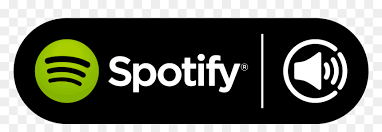

En esta notebook se realizará un motor de Recomendación de Canciones a partir de una base de datos pequeña de spotify.
Empezaré con un EDA para saber como utilizar el dataset. Luego ya que tenga entienda la base la ajustare al problema para que pueda ser mas facil de utilizarla.

# **Librerias**

In [1]:
pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

from yellowbrick.target import FeatureCorrelation

import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
import difflib

import warnings
warnings.filterwarnings("ignore")

# **Leemos los Datos**

In [3]:
data = pd.read_csv("data/data.csv")
genre_data = pd.read_csv('data/data_by_genres.csv')
year_data = pd.read_csv('data/data_by_year.csv')

Se tienen 3 archivos csv que el primero llamado data.csv cuenta con 19 columnas, genre_data cuenta con 14 columnas y el ultimo cuenta con 14 columnas.

In [4]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [7]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


Vamos a comprobar todos los parametros con la columna **'popularidad'**. Antes de ir a hacer eso vamos a comprobar la Correlación de Características considerando algunas características y para eso, voy a utilizar el paquete **yellowbrick**. Puedes aprender más sobre él en la página [documentation](https://www.scikit-yb.org/en/latest/index.html).

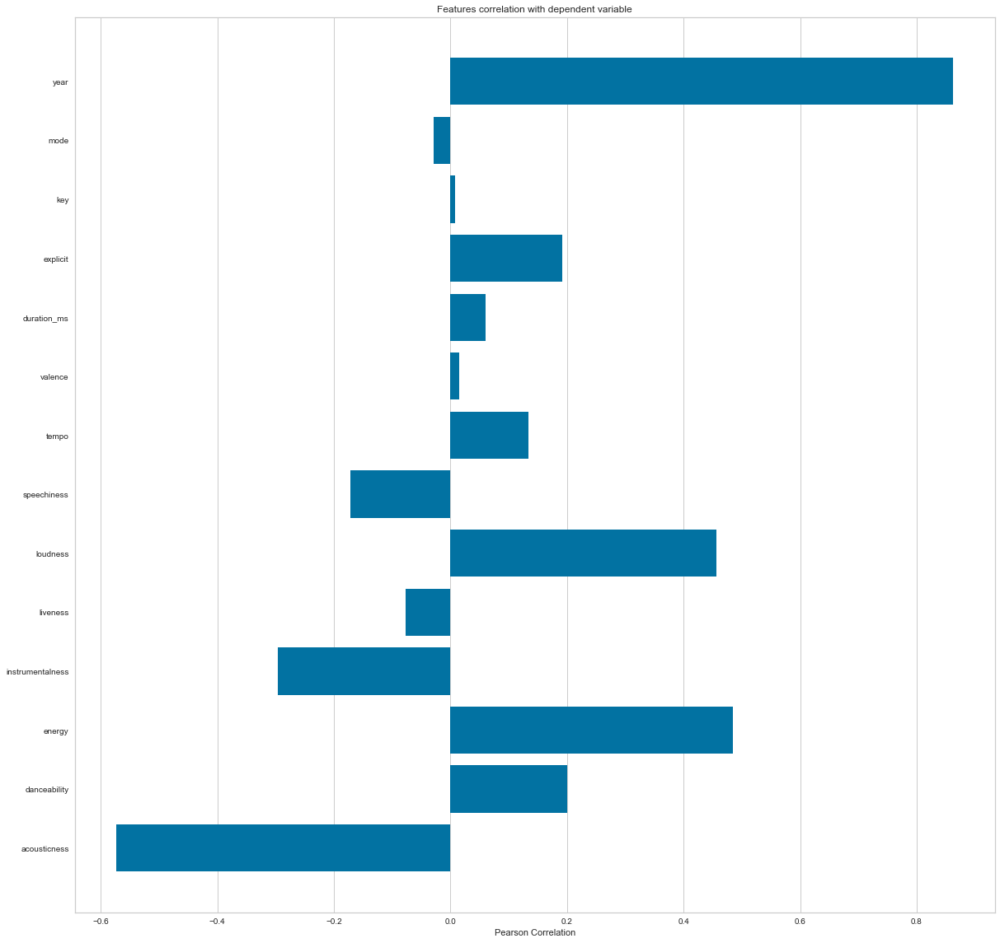

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [8]:
feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Creamos una lista con los nombres de las caracteristicas
features = np.array(feature_names)

# Creamos la instancia
visualizer = FeatureCorrelation(labels=features)

visualizer.fit(X, y)
visualizer.show()

En estadística, el coeficiente de correlación de Pearson es una medida de dependencia lineal entre dos variables aleatorias cuantitativas. A diferencia de la covarianza, la correlación de Pearson es independiente de la escala de medida de las variables.

De manera menos formal, podemos definir el coeficiente de correlación de Pearson como un índice que puede utilizarse para medir el grado de relación de dos variables siempre y cuando ambas sean cuantitativas y continuas. 

# **Analisis Exploratorio de Datos**

# **Música a lo largo del tiempo**


Usando los datos agrupados por año, podemos entender cómo ha cambiado el sonido general de la música desde 1921 hasta 2020.



<AxesSubplot:xlabel='decade', ylabel='count'>

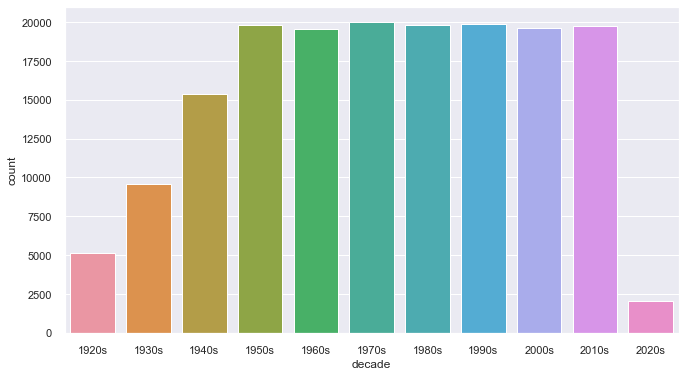

In [9]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

In [10]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

# **Características de los diferentes géneros**

Este conjunto de datos contiene las características de audio de diferentes canciones junto con las características de audio de diferentes géneros. Podemos utilizar esta información para comparar diferentes géneros y comprender sus diferencias únicas de sonido.

In [11]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

# **Agrupación de géneros con K-Means**

En este caso, se utiliza el algoritmo simple de agrupación K-means para dividir los géneros de este conjunto de datos en diez clústeres basados en las características numéricas de audio de cada género.

In [12]:
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [13]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.008s...
[t-SNE] Computed neighbors for 2973 samples in 0.232s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.111443
[t-SNE] KL divergence after 1000 iterations: 1.394954


# **Agrupación de canciones con K-Means**

In [14]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [15]:
# Visualizing the Clusters with PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# **Construcción del Motor de recomendación**

* Según el análisis y las visualizaciones, está claro que los géneros similares tienden a tener puntos de datos que se ubican cerca unos de otros, mientras que los tipos de canciones similares también se agrupan.
* Esta observación tiene mucho sentido. Los géneros similares sonarán de manera similar y provendrán de períodos de tiempo similares, mientras que lo mismo puede decirse de las canciones dentro de esos géneros. Podemos usar esta idea para construir un sistema de recomendación tomando los puntos de datos de las canciones que un usuario ha escuchado y recomendando canciones correspondientes a puntos de datos cercanos.
* [Spotipy](https://spotipy.readthedocs.io/en/2.16.1/) es un cliente de Python para la API web de Spotify que facilita a los desarrolladores la obtención de datos y la consulta de canciones en el catálogo de Spotify. Tienes que instalar usando `pip install spotipy`
* Después de instalar Spotipy, deberá crear una aplicación en la [página del desarrollador de Spotify] (https://developer.spotify.com/) y guardar su ID de cliente y clave secreta.

In [16]:
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="62cfe79d83ef43c69a7ba63f9f5debda",
                                                           client_secret="f4017bf1ef464b4ea90099b89f4ec077"))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)


In [17]:
number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=5):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [18]:
recommend_songs([{'name': 'Master Of Puppets', 'year':1986},
                {'name': 'Enter Sandman', 'year': 1991},
                {'name': 'Come As You Are', 'year': 1991},
                {'name': 'Lithium', 'year': 1993},
                {'name': 'The Trooper', 'year': 1983}],  data)

[{'name': "Rockin' in the Free World",
  'year': 1989,
  'artists': "['Neil Young']"},
 {'name': 'I Wanna Be Adored - Remastered',
  'year': 1989,
  'artists': "['The Stone Roses']"},
 {'name': 'No Easy Way Out - From "Rocky IV" Soundtrack',
  'year': 1985,
  'artists': "['Robert Tepper']"},
 {'name': 'Prófugos - Remasterizado 2007',
  'year': 1986,
  'artists': "['Soda Stereo']"},
 {'name': 'Plush - 2017 Remaster',
  'year': 1992,
  'artists': "['Stone Temple Pilots']"},
 {'name': 'Plush', 'year': 2003, 'artists': "['Stone Temple Pilots']"},
 {'name': 'Scream', 'year': 2007, 'artists': "['Avenged Sevenfold']"},
 {'name': 'Wrong Side of Heaven',
  'year': 2013,
  'artists': "['Five Finger Death Punch']"},
 {'name': 'Separate Ways (Worlds Apart)',
  'year': 2001,
  'artists': "['Journey']"},
 {'name': "You've Got Another Thing Coming",
  'year': 1982,
  'artists': "['Judas Priest']"}]

* Esta última celda te dará una lista de recomendación de canciones

* Puedes cambiar la lista de canciones según tu elección.

# Referencias
## Sistema recomendador tomado de Kaggle

### https://www.kaggle.com/code/vatsalmavani/music-recommendation-system-using-spotify-dataset